<H3>
    <P>XỬ LÝ ẢNH VÀ THỊ GIÁC MÁY TÍNH - 2019</P>
    <P>LÊ NGUYỄN SƠN NGUYÊN - CH1702039</P>
    <P>XỬ LÝ ẢNH NHIỄU SỐ 3</P>
</H3>

import các thư viện cần thiết

In [1]:
import cv2
import matplotlib.pyplot as plt

In [2]:
%matplotlib inline

In [3]:
plt.rcParams['figure.dpi'] = 500

In [4]:
img = cv2.imread('./Anh nhieu/3n.jpg', 0)

HIỂN THỊ ẢNH NHIỄU SỐ 3

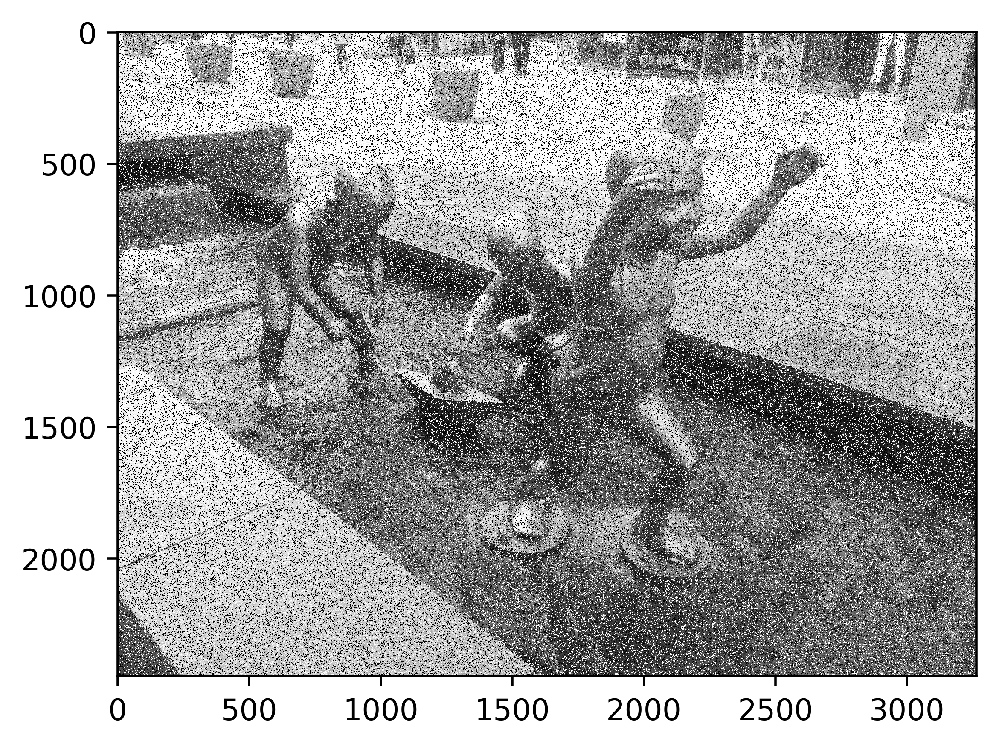

In [5]:
plt.imshow(img, cmap='gray')

In [6]:
f = np.fft.fft2(img)
fshift = np.fft.fftshift(f)

magnitude_spectrum = 20*np.log(np.abs(fshift))
magnitude_spectrum = np.asarray(magnitude_spectrum, dtype=np.uint8)

img_and_magnitude = np.concatenate((img, magnitude_spectrum), axis=1)

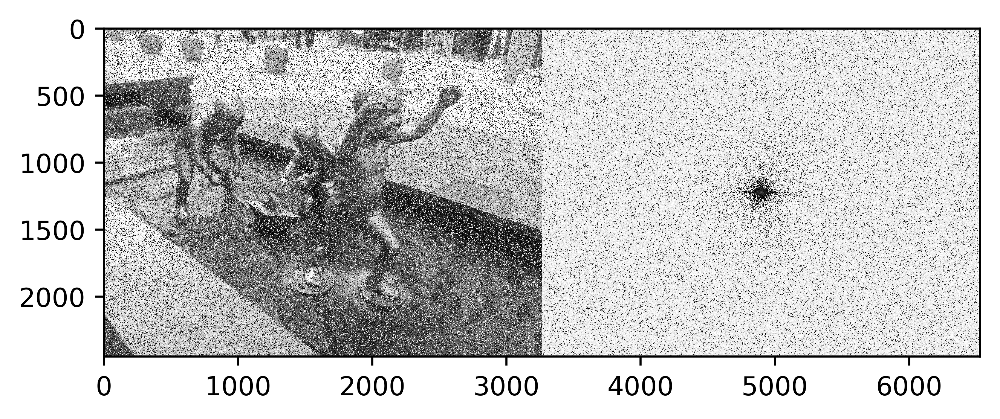

In [7]:
plt.imshow(img_and_magnitude, cmap='gray')

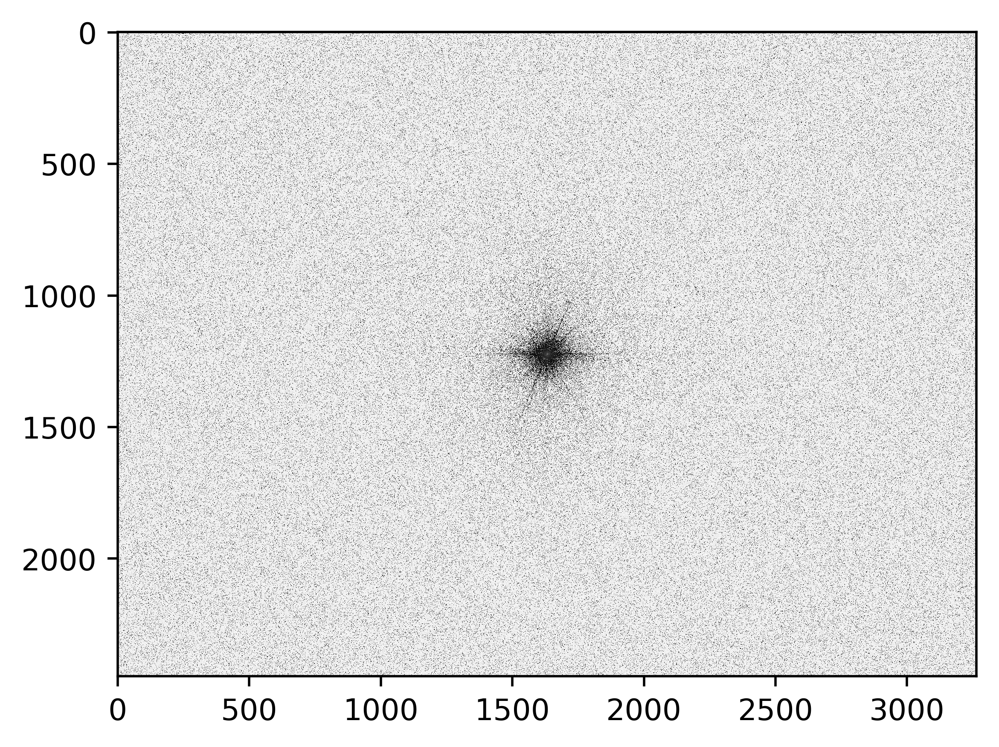

In [8]:
plt.imshow(magnitude_spectrum, cmap='gray')

lựa chọn một vùng ảnh đồng nhất

In [9]:
img_crop = cv2.imread("./Anh nhieu/3c.jpg", 0)

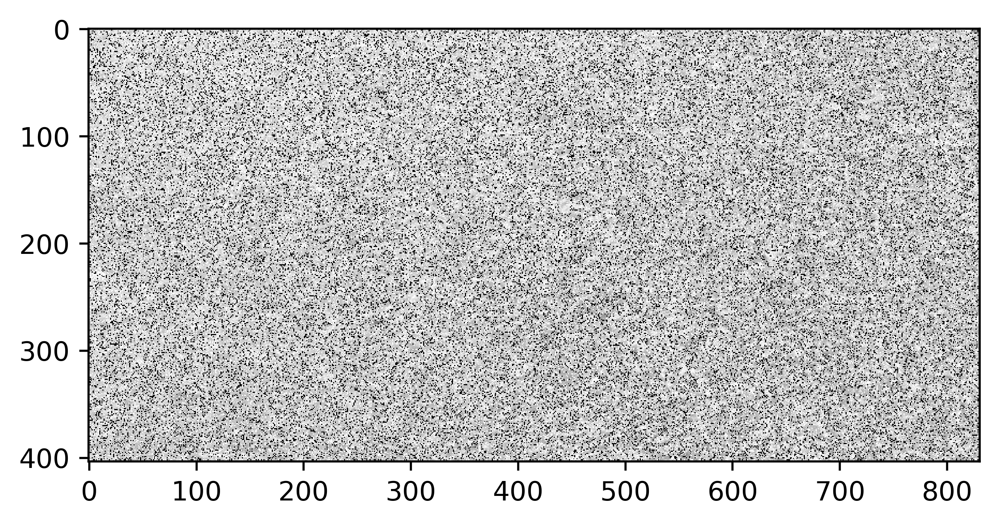

In [10]:
plt.imshow(img_crop, cmap='gray')

vẽ histogram và xác định là nhiều muối tiêu

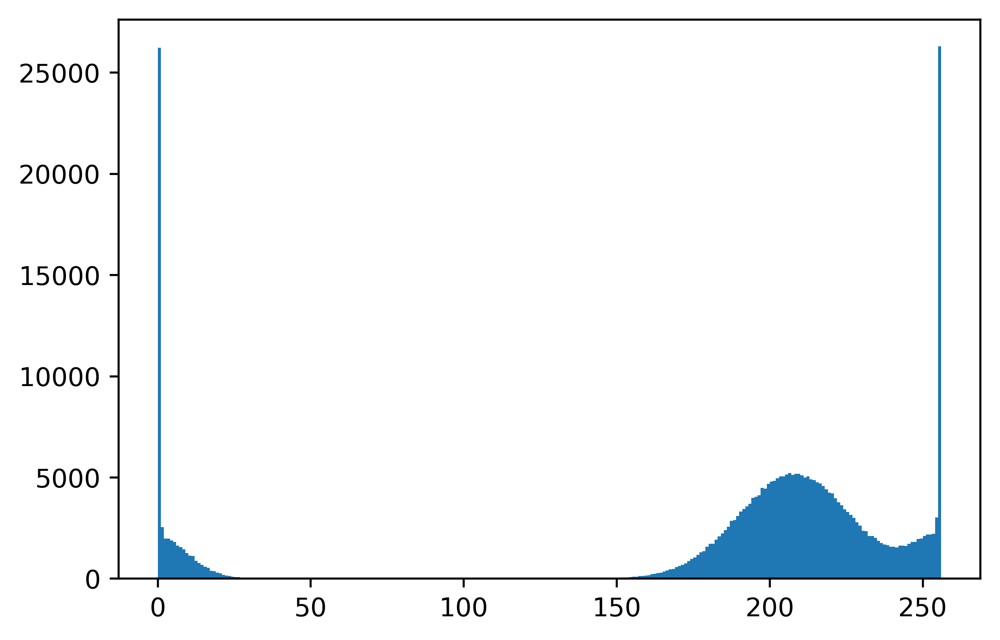

In [11]:
plt.hist(img_crop.ravel(), 256, [0, 256])
plt.show()

áp dụng bộ lọc median

In [12]:
median = cv2.medianBlur(img, 5)

hiển thị ảnh kết quả

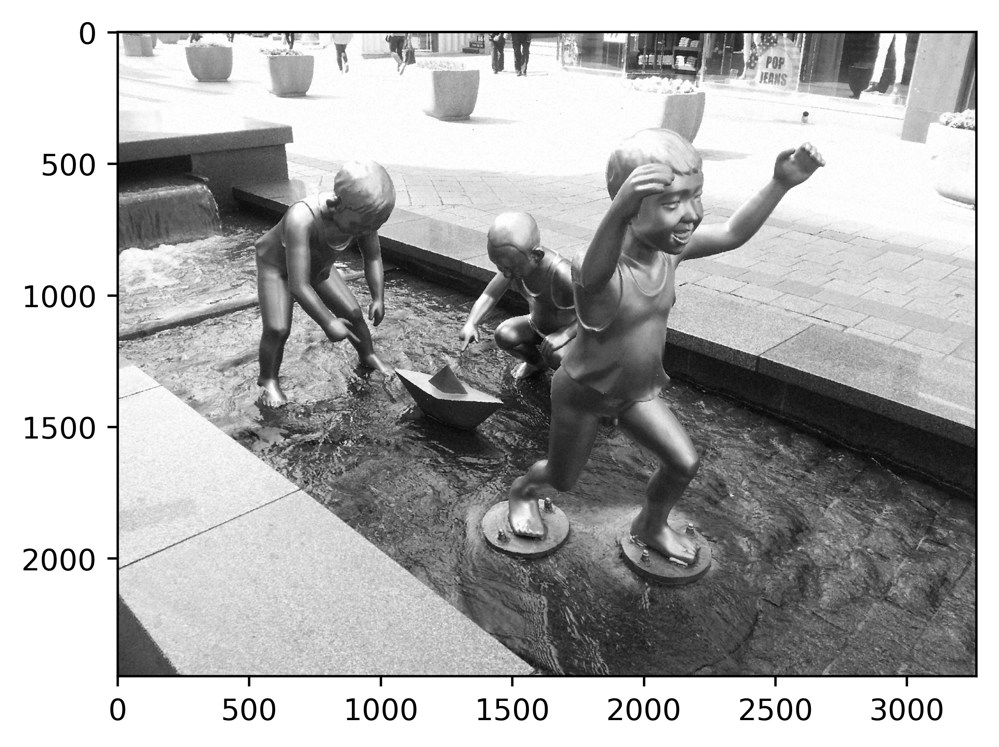

In [13]:
plt.imshow(median, cmap='gray')

In [14]:
cv2.imwrite('./Anh nhieu/3_r_median5.jpg', median)

True

In [15]:
import math
from skimage import img_as_float
from skimage.measure import compare_mse as mse

HIỂN THỊ ẢNH GỐC

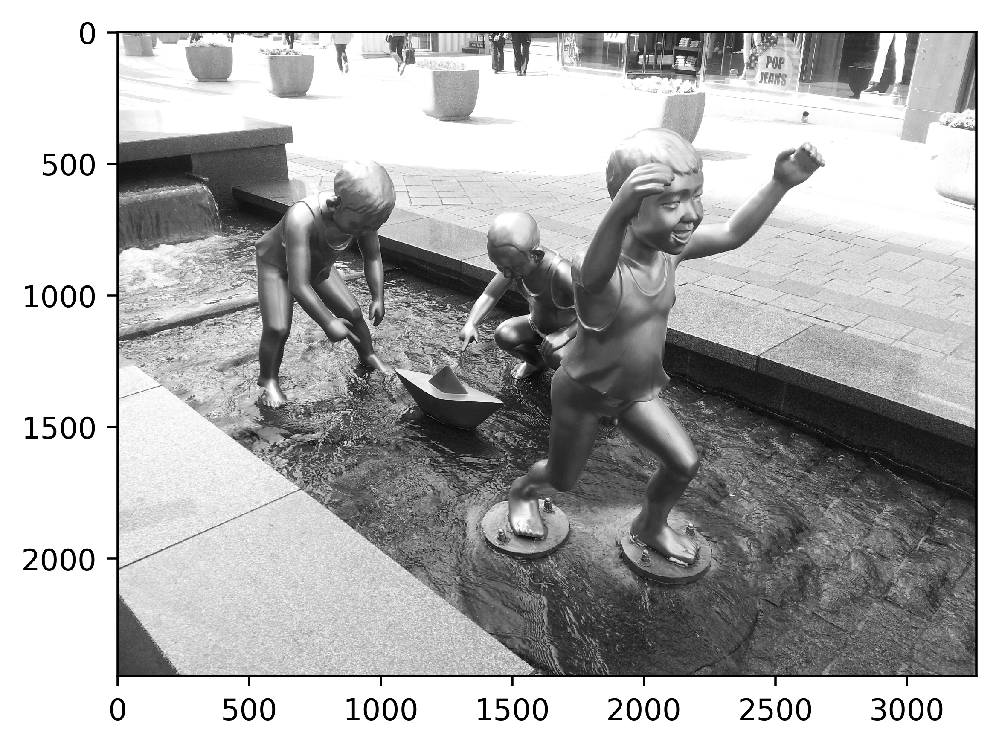

In [16]:
anh_goc = cv2.imread('./Anh nhieu/3g.jpg', 0)
plt.imshow(anh_goc, cmap='gray')

TÍNH MSE CỦA ẢNH NHIỄU SỐ 3 SO VỚI ẢNH GỐC

In [18]:
mse_noise = math.sqrt(mse(img_as_float(img), img_as_float(anh_goc)))
mse_noise

C:\Users\baole\AppData\Roaming\Python\Python36\site-packages\ipykernel_launcher.py:1: UserWarning: DEPRECATED: skimage.measure.compare_mse has been moved to skimage.metrics.mean_squared_error. It will be removed from skimage.measure in version 0.18.
  """Entry point for launching an IPython kernel.


0.3178585630159502

In [19]:
mse_denoise = math.sqrt(mse(img_as_float(median), img_as_float(anh_goc)))
mse_denoise

C:\Users\baole\AppData\Roaming\Python\Python36\site-packages\ipykernel_launcher.py:1: UserWarning: DEPRECATED: skimage.measure.compare_mse has been moved to skimage.metrics.mean_squared_error. It will be removed from skimage.measure in version 0.18.
  """Entry point for launching an IPython kernel.


0.04346508077064552